In [1]:
#Imports : 
from Modules.Module import ouverture_df, scatter_plot_2lines, scatter_plot_2lines_2y_axis, scatter_plot_2lines
from Modules.Module import plot_n_scatter_2axis, read_petrole_data, BubbleCloud, barchart
from Modules.Module import read_electricity_data, plot_from_df, plot_from_df_with_list_col, plot_first_column_from_df1_df2
from Modules.Module import change_col_to_point, read_rte_data, list_series_data, plot_subplot_resources

In [ ]:
# Etude sur le Charbon : 

In [ ]:
## Ouvertures des données : 

In [ ]:
# definition des bornes de l'étude : 
date_début = 
date_fin = 


path_prix_charbon = './Data/1.4.-Prix-menages-Bois.2023-04.csv'
prix_charbon = ouverture_df(path_prix_charbon, date_début, date_fin)


path_charbon = './Data/3.4.Charbon.2023-04.csv'
charbon = ouverture_df(path_charbon, date_début, date_fin)

path_synthese = './Data/4.5.-Synthese-Charbon.2023-04.csv'
synthese = ouverture_df(path_synthese, date_début, date_fin)

path_facture = './Data/5.-Facture-energetique.2023-04.csv'
facture = ouverture_df(path_facture, date_début, date_fin)

path_prixgros = './Data/6.-Prix-de-gros.2023-04.csv'
prixgros = ouverture_df(path_prixgros, date_début, date_fin)



In [7]:
scatter_plot_2lines(x1=prix_charbon.index,
                    y1=prix_charbon.iloc[:,1].astype(float),
                    x2=prix_charbon.index, 
                    y2=prix_charbon.iloc[:,2].astype(float),
                    label_1='granulés en vrac',
                    label_2='granulés en sac',
                    title="Evolution du prix du bois sur la période 2018-2022",
                    x_label='Temps en année',
                    y_label='Prix en €',
                    save=True,
                   path_to_save='./Visualisations/evolution_prix_charbon.jpg')

In [8]:
scatter_plot_2lines_2y_axis(x1=charbon.index,
                    y1=charbon.iloc[:,2].astype(float),
                    x2=charbon.index, 
                    y2=charbon.iloc[:,3].astype(float),
                    label_1='Importation des combustibles minéraux',
                    label_2='Exportation des combustibles minéraux',
                    title="Etude des flux de bois entre 2018 et 2022",
                    x_label='Temps en année',
                    y_label='Poids en kt',
                    save=True,
                   path_to_save='./Visualisations/import_export_charbon_2y.jpg')

In [9]:
scatter_plot_2lines(x1=charbon.index,
                    y1=charbon.iloc[:,2].astype(float),
                    x2=charbon.index, 
                    y2=charbon.iloc[:,3].astype(float),
                    label_1='Importation des combustibles minéraux',
                    label_2='Exportation des combustibles minéraux',
                    title="Etude des flux de bois entre 2018 et 2022",
                    x_label='Temps en année',
                    y_label='Poids en kt',
                    save=True,
                   path_to_save='./Visualisations/import_export_charbon.jpg')

In [ ]:
## Etude de l'inflation sur le prix du charbon :

In [ ]:
#URL : https://www.insee.fr/fr/statistiques/4268033
inflation = pd.read_csv('./Data/inflation_2018_2022.csv', sep='\t', header=None)
inflation.columns = ['Période', 'Alimentation', 'Produits manufacturés', 'Energie', 'Services', 'Tabac']
inflation.index = pd.to_datetime(inflation.Période)
inflation = inflation.applymap(lambda x: x.replace(' ', '').replace(',', '.'))
inflation_energie = inflation.loc[:,'Energie'].copy()

In [ ]:
liste_inflation = []
for idx, value in enumerate(inflation_energie):
    if idx !=0:
        inf = ((float(value) - float(inflation_energie.iloc[idx-1]))/float(inflation_energie.iloc[idx-1])*100)
        liste_inflation.append(inf)
    else :
        liste_inflation.append(0.)
inflation_energie = pd.concat([inflation_energie, pd.Series(liste_inflation, index=inflation_energie.index, name='Inflation')], axis=1)

In [ ]:
prix_charbon_inflation = pd.concat([prix_charbon, inflation_energie.Inflation], axis=1)
prix_charbon_inflation.iloc[:,1:5] = prix_charbon_inflation.iloc[:,1:5].astype(float)
prix_charbon_inflation.iloc[:,1] = prix_charbon_inflation.iloc[:,1]*(100-prix_charbon_inflation.iloc[:,5].astype(float))/100
prix_charbon_inflation.iloc[:,2] = prix_charbon_inflation.iloc[:,2]*(100-prix_charbon_inflation.iloc[:,5].astype(float))/100
prix_charbon_inflation.iloc[:,3] = prix_charbon_inflation.iloc[:,3]*(100-prix_charbon_inflation.iloc[:,5].astype(float))/100
prix_charbon_inflation.iloc[:,4] = prix_charbon_inflation.iloc[:,4]*(100-prix_charbon_inflation.iloc[:,5].astype(float))/100

In [ ]:
prix_charbon_inflation.head()

In [ ]:
scatter_plot_2lines(prix_charbon_inflation.index, 
                    prix_charbon_inflation.iloc[:,1], 
                    prix_charbon_inflation.index, 
                    prix_charbon_inflation.iloc[:,2], 
                    'Granulés en vrac',
                    'Granulés en sac', 
                    'Evolution du prix d\'une tonne de bois corrigé par l\'inflation', 
                    'Temps en année', 
                    'Prix en €/t', 
                    save=True, 
                    path_to_save='Prix_charbon_inflation.png')

In [ ]:
# Etude du mix énergétique en france : 

In [ ]:
df_nuc_fr = pd.read_csv('./Data/disponibilite-du-parc-nucleaire-d-edf-sa-depuis-2002.csv', sep=';')

In [ ]:
df_nuc_fr

In [ ]:
fig = go.Figure()
fig.add_trace(go.Bar(x=df_nuc_fr.annee, y=df_nuc_fr.coefficient_de_disponibilite))
fig.add_trace(go.Scatter(x=df_nuc_fr.annee, y=df_nuc_fr.coefficient_de_disponibilite))
fig.show()

In [ ]:
mix_ener = pd.read_csv('./Data/origine-de-lelectricite-fournie-par-edf-sa.csv', sep=';')
# Liste des années présente dans le jeu de données :
annees = list(mix_ener.annee.unique())
dict_ = {annee: mix_ener.loc[mix_ener.loc[:,'annee']==annee] for annee in annees}
# _2021 = mix_ener.loc[mix_ener.loc[:,'annee']==2021]
# _2020 = mix_ener.loc[mix_ener.loc[:,'annee']==2020]
# _2019 = mix_ener.loc[mix_ener.loc[:,'annee']==2019]
# _2018 = mix_ener.loc[mix_ener.loc[:,'annee']==2018]
# _2017 = mix_ener.loc[mix_ener.loc[:,'annee']==2017]

In [ ]:
_2021

In [ ]:
fig = go.Figure(data=[go.Pie(labels=_2021.sous_categorie, values=_2021.valeur)])
fig.update_layout(title_text='Répartition du mix energétique pour 2021', title_x=0.5, legend_title_text = "Légende :", width=800, height=600,template='plotly_white')
fig.update_traces(textfont_size=20)
fig.show()

In [ ]:
fig = make_subplots()
    
    data=[go.Pie(labels=_2021.sous_categorie, values=_2021.valeur)]
fig.update_layout(title_text='Répartition du mix energétique pour 2021', title_x=0.5, legend_title_text = "Légende :", width=800, height=600,template='plotly_white')
fig.update_traces(textfont_size=20)
fig.show()

## Etude sur le Pétrole

In [16]:
import pandas as pd
import numpy as np
import os
import datetime as dt
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import random
import circlify
import sys

### Conso, import, export

#### Etude de l'évolution de la consommation, des importations, des exportations et du prix des produits pétroliers en France entre 2018 et 2023 (données: https://www.statistiques.developpement-durable.gouv.fr/catalogue?page=dataset&datasetId=631b03afb61e5c6479370169)

In [4]:
df_list = read_petrole_data('2018-01-01', '2023-01-01')

4.4.-Synthese-Petrole.2023-04.csv
2.1.-Prix-industriels-Petrole.2023-04.csv
3.3.Petrole.2023-04.csv
1.1.-Prix-menages-Petrole.2023-04.csv
4


In [5]:
## Prix industriels
df_list[1].head()

,Prix au détail d'une tonne FOL HTS,Prix au détail d'une tonne FOL BTS,Prix au détail d'une tonne OL TBTS,Prix au détail de 100 kWh PCI de FOL HTS,Prix au détail de 100 kWh PCI de FOL BTS,Prix au détail de 100 kWh PCI de FOL TBTS
Période,,,,,,
2021-12-01,NaN,NaN,650.6000,NaN,NaN,5.8718
2020-03-01,NaN,NaN,414.1880,NaN,NaN,3.7382
2021-09-01,NaN,NaN,622.8525,NaN,NaN,5.6214
2021-05-01,NaN,NaN,563.5330,NaN,NaN,5.0860
2020-08-01,NaN,NaN,454.4030,NaN,NaN,4.1011


In [6]:
## Synthèse pétrole
df_list[0].head()

,1. Production de pétrole (en GWh),2. Solde importateur (importations - exportations) tous produits pétroliers (en GWh),2.1 Importations de tous produits pétroliers (en GWh),"2.1.1 Importations de pétrole brut, condensats et autres produits à distiller (en GWh)",2.1.2 Importations de produits pétroliers raffinés (en GWh),2.2 Exportations de produits pétroliers raffinés (en GWh),3. Solde importateur (importations - exportations) de produits pétroliers raffinés (en GWh),4. Marché des soutes maritimes (françaises et étrangères) (en GWh),5. Consommation réelle de pétrole (brut et raffiné) (en GWh),6. Consommation de pétrole (brut et raffiné) CVC-CJO (en GWh),7. Consommation de pétrole (brut et raffiné) CVS-CVC-CJO (en GWh),"8. Degrés jours unifiés mensuels en France, pour la période de chauffe (vaut 0 de juin à septembre, en °C)",9. Indice de rigueur climatique pour la France métropolitaine (ref.1 pour la période de référence) (sans unité)
Période,,,,,,,,,,,,,
2022-07-01,560.082,73057.618,86313.328,46129.023,40184.305,13255.710,26928.595,1345.591,70144.669,71845.910,66703.586,0.000,1.000
2022-10-01,557.195,73363.349,82922.651,28482.614,54440.037,9559.303,44880.734,1093.220,64540.395,66978.767,62504.364,37.950,0.305
2019-11-01,717.652,69321.180,83638.258,37576.949,46061.309,14317.078,31744.231,908.303,70062.367,70618.518,72395.346,258.921,1.019
2021-05-01,662.733,63910.446,72906.983,28836.097,44070.887,8996.537,35074.350,1207.194,60020.086,59594.120,62996.937,116.452,1.485
2021-06-01,639.352,66366.403,75393.179,34639.269,40753.910,9026.776,31727.134,1114.154,68802.859,66305.484,65436.035,0.000,1.000


In [7]:
## Pétrole
df_list[2].head()

,1. Production de pétrole (brut et hydrocarbures extraits du gaz naturel en kt),1.1 Production de pétrole brut (en kt),1.2 Production d'hydrocarbures extraits du gaz naturel (en kt),2. Solde importateur (importations - exportations) tous produits pétroliers (en kt),2.1 Importations totales de produits pétroliers (en kt),2.1.1 Importations de pétrole brut et condensats (en kt),2.1.2 Importations d'autres produits à distiller (APD) (en kt),2.1.3 Importations de produits pétroliers raffinés (en kt),2.2 Exportations de produits pétroliers raffinés (en kt),3. Marché des soutes maritimes (françaises et étrangères) (en kt),...,7.3 Ventes de gazole CVS-CVC-CJO (en kt),7.4 Ventes de fioul domestique (FOD) CVS-CVC-CJO (en kt),7.5 Ventes de gazole non routier CVS-CVC-CJO (en kt),7.6 Ventes de carburéacteurs CVS-CVC-CJO (en kt),"7.7 Ventes de gaz de pétrole liquéfiés (GPL : Butane, Propane, GPL-carburant) CVS-CVC-CJO (en kt)","7.9 Autres produits (hors gazole, supercarburants, carburéacteurs, FOD, GnR, GPL, pétrochimie, dont usages non-énergétique) CVS-CVC-CJO (en kt)","8. Ventes de produits à usage non énergétique, y compris bases pétrochimie (en kt)",9. Consommation de carburants routiers (en kt),"10. Degrés jours unifiés mensuels en France, pour la période de chauffe (vaut 0 de juin à septembre, en °C)",11. Indice de rigueur climatique pour la France métropolitaine (ref.1 pour la période de référence) (sans unité)
Période,,,,,,,,,,,,,,,,,,,,,
2019-07-01,51.300,51.300,0.0,6703.383,7981.905,4294.461,0.0,3754.921,1345.999,174.9,...,2800.819,484.935,399.456,636.294,139.149,433.921,1104.764,4010.977,0.000,1.000
2021-07-01,55.084,55.084,0.0,5641.868,6571.721,3432.703,0.0,3139.018,929.853,100.9,...,2681.622,443.236,370.087,303.820,147.405,400.922,1065.432,3807.311,0.000,1.000
2023-01-01,49.969,49.969,0.0,6288.736,7266.098,4086.000,0.0,3259.098,1056.361,85.5,...,2599.764,341.770,371.257,553.124,118.753,320.340,679.257,3278.958,336.034,0.906
2022-07-01,48.158,48.158,0.0,6281.824,7421.610,3966.382,0.0,3455.228,1139.786,115.7,...,2595.369,383.633,380.716,408.270,137.527,359.626,976.715,3617.723,0.000,1.000
2022-02-01,48.460,48.460,0.0,5211.246,6017.790,3101.502,0.0,2938.554,828.810,60.2,...,2656.092,443.913,398.922,384.733,145.051,388.671,773.460,3172.526,255.808,0.800


In [8]:
df_list[2].info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 61 entries, 2019-07-01 to 2022-08-01
Data columns (total 45 columns):
 #   Column                                                                                                                                           Non-Null Count  Dtype  
---  ------                                                                                                                                           --------------  -----  
 0   1. Production de pétrole (brut et hydrocarbures extraits du gaz naturel en kt)                                                                   61 non-null     float64
 1   1.1 Production de pétrole brut (en kt)                                                                                                           61 non-null     float64
 2   1.2 Production d'hydrocarbures extraits du gaz naturel (en kt)                                                                                   61 non-null     float64
 3   2.

In [9]:
df_list[2].columns

Index(['1. Production de pétrole (brut et hydrocarbures extraits du gaz naturel en kt)',
       '1.1 Production de pétrole brut (en kt)',
       '1.2 Production d'hydrocarbures extraits du gaz naturel (en kt)',
       '2. Solde importateur (importations - exportations) tous produits pétroliers (en kt)',
       '2.1 Importations totales de produits pétroliers (en kt)',
       '2.1.1 Importations de pétrole brut et condensats (en kt)',
       '2.1.2 Importations d'autres produits à distiller (APD) (en kt)',
       '2.1.3 Importations de produits pétroliers raffinés (en kt)',
       '2.2 Exportations de produits pétroliers raffinés (en kt)',
       '3. Marché des soutes maritimes (françaises et étrangères) (en kt)',
       '5. Consommation totale de produits pétroliers nette de l'autoconsommation des raffineries  (en kt)',
       '5.1 Ventes totales de fioul lourd (FOL) (en kt)',
       '5.1.1 Ventes de fioul lourd (FOL) à l'industrie (en kt)',
       '5.1.2 Ventes de fioul lourd (FOL) au

In [10]:
## Prix ménages
df_list[3].head()

,Tarif d'une tonne de propane en citerne,Prix au détail de 100 kWh PCI de propane en citerne,Prix d'une tonne de propane,Prix au détail de 100 kWh PCS de propane,Prix au détail de 100 kWh PCI de propane,Prix au détail d'une bouteille de butane de 13 kg,Prix au détail de 100 litres de FOD au tarif C1,Prix au détail de 10 kWh PCI de FOD au tarif C1,Prix au détail d'un litre d'essence ordinaire,Prix au détail d'un litre de super carburant ARS,Prix au détail d'un litre de super sans plomb 95,Prix au détail d'un litre de super sans plomb 98,Prix au détail d'un litre de gazole,Prix au détail d'un litre de GPLc,Prix au détail d'un litre de super sans plomb 95-E10,Prix au détail d'un litre de superéthanol E85
Période,,,,,,,,,,,,,,,,
2020-11-01,NaN,NaN,1851.0749,13.4136,14.4842,NaN,70.7000,7.1328,NaN,NaN,1.3280,1.3920,1.2160,0.8390,1.3117,0.6495
2021-09-01,NaN,NaN,2082.5521,15.0910,16.2954,35.43,91.3525,9.2164,NaN,NaN,1.5827,1.6443,1.4477,0.8530,1.5574,0.6746
2022-12-01,NaN,NaN,2052.8569,14.8758,16.0631,40.28,133.8720,13.5061,NaN,NaN,1.6842,1.7400,1.7622,0.8846,1.6421,0.8785
2021-08-01,NaN,NaN,1808.0997,13.1022,14.1479,35.15,89.1025,8.9894,NaN,NaN,1.5800,1.6430,1.4321,0.8582,1.5565,0.6773
2019-10-01,NaN,NaN,1910.1409,13.8416,14.9463,34.67,92.8000,9.3624,NaN,NaN,1.5000,1.5610,1.4410,0.8590,NaN,NaN


In [11]:
## trie des dates pour pouvoir faire les figures
df_list[3] = df_list[3].sort_index()
df_list[2] = df_list[2].sort_index()
df_list[1] = df_list[1].sort_index()
df_list[0] = df_list[0].sort_index()

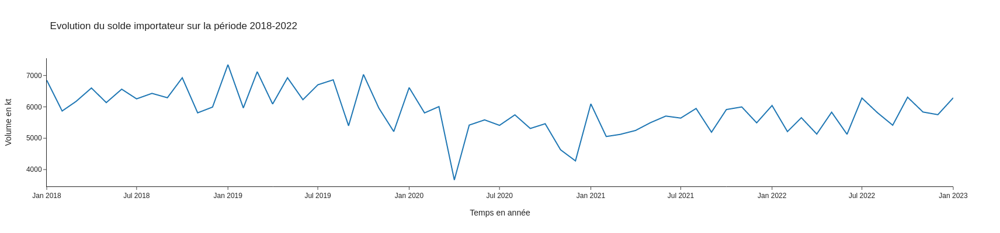

In [17]:
## Solde importateur de pétrole
fig = go.Figure()
fig.add_trace(go.Scatter(x=df_list[3].index, y=df_list[2]["2. Solde importateur (importations - exportations) tous produits pétroliers (en kt)"], name='Solde importateur en kt'))
fig.update_layout(title_text="Evolution du solde importateur sur la période 2018-2022", legend_title_text = "Légende :", width=800, height=400, template='simple_white')
fig.update_xaxes(title_text='Temps en année')
fig.update_yaxes(title_text='Volume en kt')
fig.show()

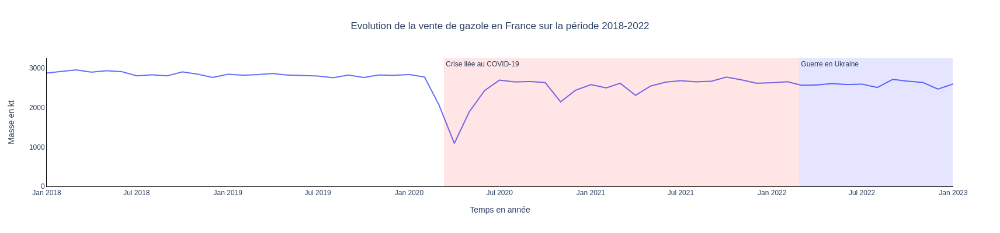

In [18]:
# Vente de gazole en France
scatter_plot_2lines(x1 = df_list[2].index, y1 = df_list[2]["7.3 Ventes de gazole CVS-CVC-CJO (en kt)"], label_1 = 'Vente de gazole en kt', x_label = 'Temps en année',
                    y_label = 'Masse en kt', title = "Evolution de la vente de gazole en France sur la période 2018-2022")

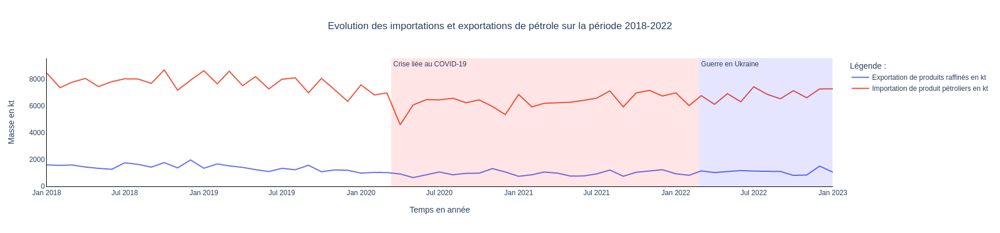

In [19]:
# Import et export de pétrole
scatter_plot_2lines(x1 = df_list[2].index, y1 = df_list[2]["2.2 Exportations de produits pétroliers raffinés (en kt)"], x2 = df_list[2].index,
                    y2 = df_list[2]["2.1 Importations totales de produits pétroliers (en kt)"], label_1 = 'Exportation de produits raffinés en kt', label_2 = 'Importation de produit pétroliers en kt', x_label = 'Temps en année',
                    y_label = 'Masse en kt', title = "Evolution des importations et exportations de pétrole sur la période 2018-2022")

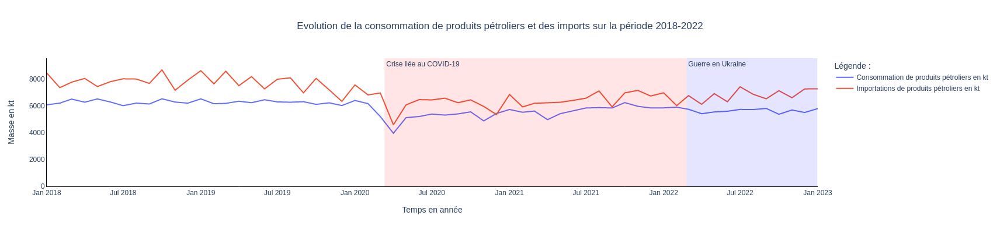

In [20]:
# Consommation vs importation
scatter_plot_2lines(x1 = df_list[2].index, y1 = df_list[2]["7. Consommation totale de produits pétroliers CVS-CVC-CJO (en kt)"], x2 = df_list[2].index,
                    y2 = df_list[2]["2.1 Importations totales de produits pétroliers (en kt)"], label_1 = 'Consommation de produits pétroliers en kt', label_2 = 'Importations de produits pétroliers en kt', x_label = 'Temps en année',
                    y_label = 'Masse en kt', title = "Evolution de la consommation de produits pétroliers et des imports sur la période 2018-2022")

In [21]:
df_list[0].columns

Index(['1. Production de pétrole (en GWh)',
       '2. Solde importateur (importations - exportations) tous produits pétroliers (en GWh)',
       '2.1 Importations de tous produits pétroliers (en GWh)',
       '2.1.1 Importations de pétrole brut, condensats et autres produits à distiller (en GWh)',
       '2.1.2 Importations de produits pétroliers raffinés (en GWh)',
       '2.2 Exportations de produits pétroliers raffinés (en GWh)',
       '3. Solde importateur (importations - exportations) de produits pétroliers raffinés (en GWh)',
       '4. Marché des soutes maritimes (françaises et étrangères) (en GWh)',
       '5. Consommation réelle de pétrole (brut et raffiné) (en GWh)',
       '6. Consommation de pétrole (brut et raffiné) CVC-CJO (en GWh)',
       '7. Consommation de pétrole (brut et raffiné) CVS-CVC-CJO (en GWh)',
       '8. Degrés jours unifiés mensuels en France, pour la période de chauffe (vaut 0 de juin à septembre, en °C)',
       '9. Indice de rigueur climatique pour la

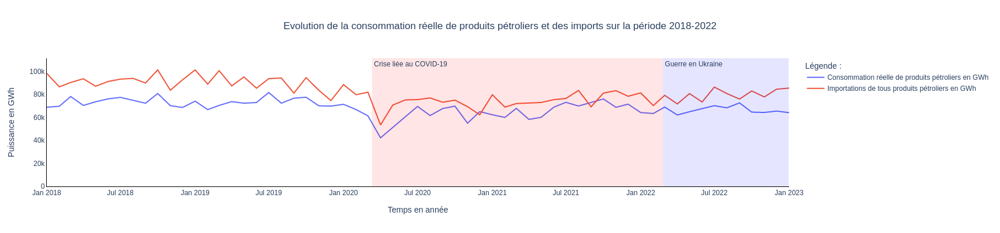

In [22]:
# Conso vs import en GWH
scatter_plot_2lines(x1 = df_list[0].index, y1 = df_list[0]["5. Consommation réelle de pétrole (brut et raffiné) (en GWh)"], x2 = df_list[0].index,
                    y2 = df_list[0]["2.1 Importations de tous produits pétroliers (en GWh)"], label_1 = 'Consommation réelle de produits pétroliers en GWh', label_2 = 'Importations de tous produits pétroliers en GWh', x_label = 'Temps en année',
                    y_label = 'Puissance en GWh', title = "Evolution de la consommation réelle de produits pétroliers et des imports sur la période 2018-2022")

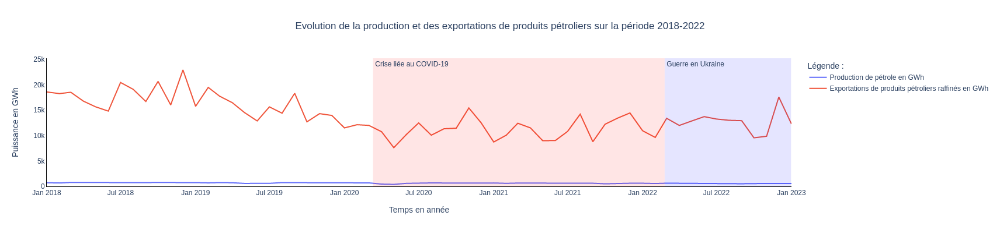

In [23]:
## Production vs exportations
scatter_plot_2lines(x1 = df_list[0].index, y1 = df_list[0]["1. Production de pétrole (en GWh)"], x2 = df_list[0].index,
                    y2 = df_list[0]["2.2 Exportations de produits pétroliers raffinés (en GWh)"], label_1 = 'Production de pétrole en GWh', label_2 = 'Exportations de produits pétroliers raffinés en GWh', x_label = 'Temps en année',
                    y_label = 'Puissance en GWh', title = "Evolution de la production et des exportations de produits pétroliers sur la période 2018-2022")

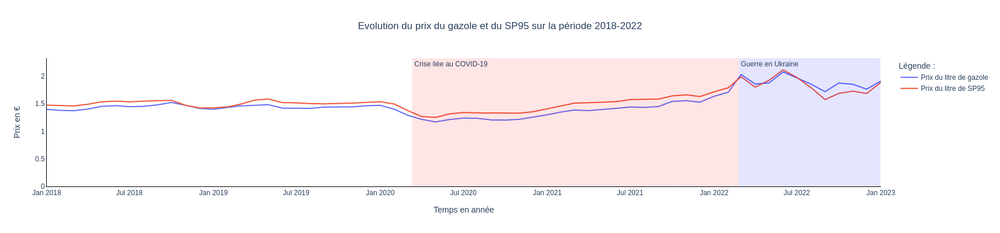

In [24]:
## Prix à la pompe du gazole et du SP95
scatter_plot_2lines(x1 = df_list[3].index, y1 = df_list[3]["Prix au détail d'un litre de gazole"], label_1 = 'Prix du litre de gazole',
                    x2 = df_list[3].index, y2 = df_list[3]["Prix au détail d'un litre de super sans plomb 95"], label_2 = 'Prix du litre de SP95', x_label = 'Temps en année', y_label = 'Prix en €',
                    title = "Evolution du prix du gazole et du SP95 sur la période 2018-2022")

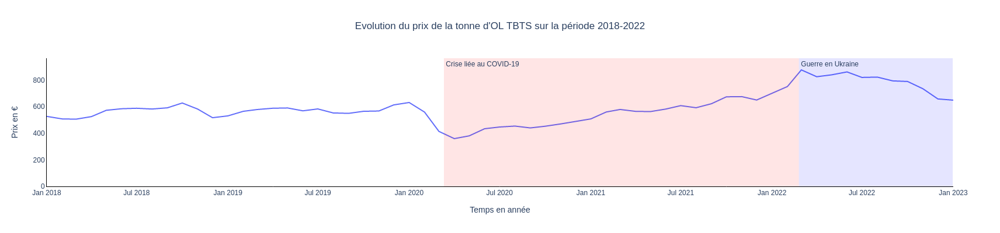

In [25]:
scatter_plot_2lines(x1 = df_list[1].index, y1 = df_list[1]["Prix au détail d'une tonne OL TBTS"], label_1 = "Prix de la tonne d'OL TBTS",
                    x_label = 'Temps en année', y_label = 'Prix en €',
                    title = "Evolution du prix de la tonne d'OL TBTS sur la période 2018-2022")

In [26]:
df_list[3]

,Tarif d'une tonne de propane en citerne,Prix au détail de 100 kWh PCI de propane en citerne,Prix d'une tonne de propane,Prix au détail de 100 kWh PCS de propane,Prix au détail de 100 kWh PCI de propane,Prix au détail d'une bouteille de butane de 13 kg,Prix au détail de 100 litres de FOD au tarif C1,Prix au détail de 10 kWh PCI de FOD au tarif C1,Prix au détail d'un litre d'essence ordinaire,Prix au détail d'un litre de super carburant ARS,Prix au détail d'un litre de super sans plomb 95,Prix au détail d'un litre de super sans plomb 98,Prix au détail d'un litre de gazole,Prix au détail d'un litre de GPLc,Prix au détail d'un litre de super sans plomb 95-E10,Prix au détail d'un litre de superéthanol E85
Période,,,,,,,,,,,,,,,,
2018-01-01,NaN,NaN,1779.9084,12.8979,13.9273,32.12,87.2000,8.7974,NaN,NaN,1.4740,1.5410,1.3960,0.8110,NaN,NaN
2018-02-01,NaN,NaN,1776.9197,12.8762,13.9039,32.21,85.4000,8.6158,NaN,NaN,1.4680,1.5340,1.3780,0.8110,NaN,NaN
2018-03-01,NaN,NaN,1804.5128,13.0762,14.1198,32.24,85.2000,8.5957,NaN,NaN,1.4590,1.5240,1.3720,0.8100,NaN,NaN
2018-04-01,NaN,NaN,1840.1891,13.3347,14.3990,32.49,87.2000,8.7974,NaN,NaN,1.4890,1.5540,1.4020,0.8040,NaN,NaN
2018-05-01,NaN,NaN,1822.5010,13.2065,14.2606,32.69,91.4000,9.2212,NaN,NaN,1.5330,1.5990,1.4510,0.8070,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-09-01,NaN,NaN,1986.5249,14.3951,15.5440,39.58,153.2640,15.4625,NaN,NaN,1.5727,1.6103,1.7172,0.7490,1.5088,0.6702
2022-10-01,NaN,NaN,2073.5001,15.0254,16.2246,39.90,166.1425,16.7618,NaN,NaN,1.6871,1.7183,1.8744,0.7464,1.6232,0.7597
2022-11-01,NaN,NaN,2032.3137,14.7269,15.9023,40.15,148.3800,14.9698,NaN,NaN,1.7261,1.7726,1.8502,0.8136,1.6765,0.8540


### Provenance du pétrole importé

#### Etude de la provenance des imports de pétrole brut en France jusqu'en 2021 (données: https://www.insee.fr/fr/statistiques/2119697)

In [27]:
data_imp = pd.read_csv('Data/Provenance_petrole.csv', sep = ';')
data_imp['Provenance'][data_imp['Provenance'] == 'Russie'] = 'Dont Russie'
data_imp['Provenance'][data_imp['Provenance'] == 'Arabie saoudite'] = 'Dont Arabie saoudite'
data_imp.head(10)

/tmp/ipykernel_19018/3226208750.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_19018/3226208750.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,Provenance,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021 (p),2021 (p)\n(en %)
0,Afrique,18.8,20.9,19.4,19.8,20.4,16.2,15.7,17.7,16.2,10.1,12.6,37.1
1,URSS/ex-URSS,23.4,18.4,16.9,15.1,16.1,17.0,19.6,16.8,14.3,8.7,7.7,22.7
2,Dont Russie,9.6,8.3,6.8,5.4,4.7,5.8,8.9,7.6,6.2,2.9,3.0,8.8
3,Moyen-Orient,12.2,9.8,11.9,12.9,14.3,14.0,14.0,12.6,10.2,5.1,5.0,14.7
4,Dont Arabie saoudite,6.7,7.8,10.2,11.1,10.6,8.3,6.2,8.0,7.3,3.9,2.6,7.7
5,Mer du Nord,9.7,6.8,7.4,6.5,5.7,6.6,7.0,4.1,3.7,4.3,3.5,10.3
6,Autres,1.1,1.8,1.1,0.7,1.7,2.3,1.4,2.0,4.3,4.9,5.2,15.2
7,Importations totales,65.1,57.6,56.7,54.9,58.3,56.0,57.8,53.3,48.7,33.2,34.0,100.0


In [28]:
data_imp_prop = data_imp.T.rename(columns=data_imp.T.iloc[0]).iloc[1:-1]
for c in data_imp_prop.columns[:-1]:
    data_imp_prop[c] = data_imp_prop[c]/data_imp_prop['Importations totales']
data_imp_prop

,Afrique,URSS/ex-URSS,Dont Russie,Moyen-Orient,Dont Arabie saoudite,Mer du Nord,Autres,Importations totales
2011,0.288786,0.359447,0.147465,0.187404,0.102919,0.149002,0.016897,65.1
2012,0.362847,0.319444,0.144097,0.170139,0.135417,0.118056,0.03125,57.6
2013,0.342152,0.29806,0.119929,0.209877,0.179894,0.130511,0.0194,56.7
2014,0.360656,0.275046,0.098361,0.234973,0.202186,0.118397,0.01275,54.9
2015,0.349914,0.276158,0.080617,0.245283,0.181818,0.09777,0.02916,58.3
2016,0.289286,0.303571,0.103571,0.25,0.148214,0.117857,0.041071,56.0
2017,0.271626,0.3391,0.153979,0.242215,0.107266,0.121107,0.024221,57.8
2018,0.332083,0.315197,0.142589,0.236398,0.150094,0.076923,0.037523,53.3
2019,0.332649,0.293634,0.12731,0.209446,0.149897,0.075975,0.088296,48.7
2020,0.304217,0.262048,0.087349,0.153614,0.11747,0.129518,0.14759,33.2


<Axes: >

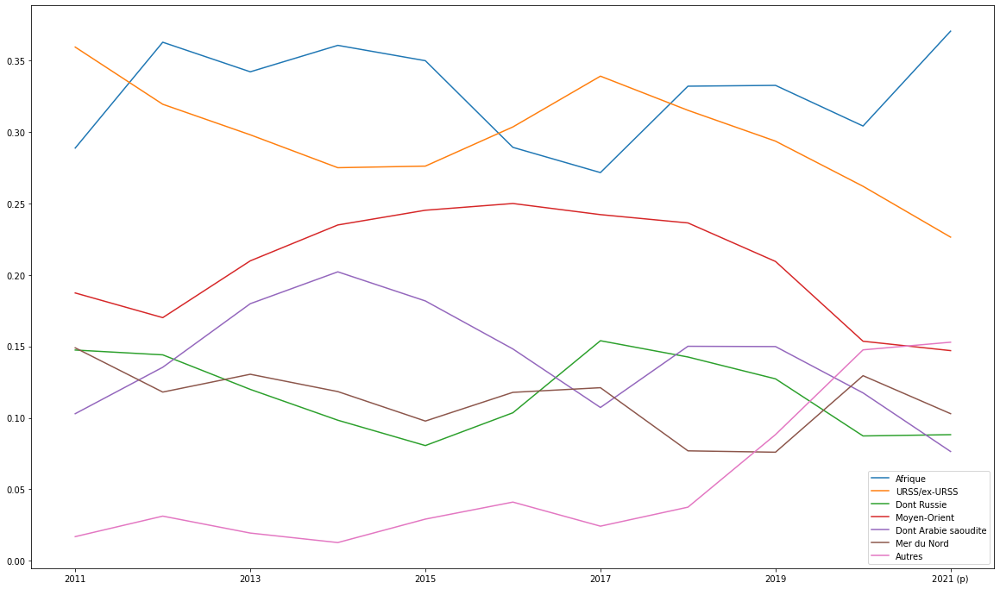

In [29]:
data_imp_prop.iloc[:, :-1].plot(figsize = (20,12))

In [30]:
data_imp_prop

,Afrique,URSS/ex-URSS,Dont Russie,Moyen-Orient,Dont Arabie saoudite,Mer du Nord,Autres,Importations totales
2011,0.288786,0.359447,0.147465,0.187404,0.102919,0.149002,0.016897,65.1
2012,0.362847,0.319444,0.144097,0.170139,0.135417,0.118056,0.03125,57.6
2013,0.342152,0.29806,0.119929,0.209877,0.179894,0.130511,0.0194,56.7
2014,0.360656,0.275046,0.098361,0.234973,0.202186,0.118397,0.01275,54.9
2015,0.349914,0.276158,0.080617,0.245283,0.181818,0.09777,0.02916,58.3
2016,0.289286,0.303571,0.103571,0.25,0.148214,0.117857,0.041071,56.0
2017,0.271626,0.3391,0.153979,0.242215,0.107266,0.121107,0.024221,57.8
2018,0.332083,0.315197,0.142589,0.236398,0.150094,0.076923,0.037523,53.3
2019,0.332649,0.293634,0.12731,0.209446,0.149897,0.075975,0.088296,48.7
2020,0.304217,0.262048,0.087349,0.153614,0.11747,0.129518,0.14759,33.2


In [31]:
data_imp_prop = data_imp_prop[data_imp_prop.columns[:-1]].T
data_imp_prop

,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021 (p)
Afrique,0.288786,0.362847,0.342152,0.360656,0.349914,0.289286,0.271626,0.332083,0.332649,0.304217,0.370588
URSS/ex-URSS,0.359447,0.319444,0.29806,0.275046,0.276158,0.303571,0.3391,0.315197,0.293634,0.262048,0.226471
Dont Russie,0.147465,0.144097,0.119929,0.098361,0.080617,0.103571,0.153979,0.142589,0.12731,0.087349,0.088235
Moyen-Orient,0.187404,0.170139,0.209877,0.234973,0.245283,0.25,0.242215,0.236398,0.209446,0.153614,0.147059
Dont Arabie saoudite,0.102919,0.135417,0.179894,0.202186,0.181818,0.148214,0.107266,0.150094,0.149897,0.11747,0.076471
Mer du Nord,0.149002,0.118056,0.130511,0.118397,0.09777,0.117857,0.121107,0.076923,0.075975,0.129518,0.102941
Autres,0.016897,0.03125,0.0194,0.01275,0.02916,0.041071,0.024221,0.037523,0.088296,0.14759,0.152941


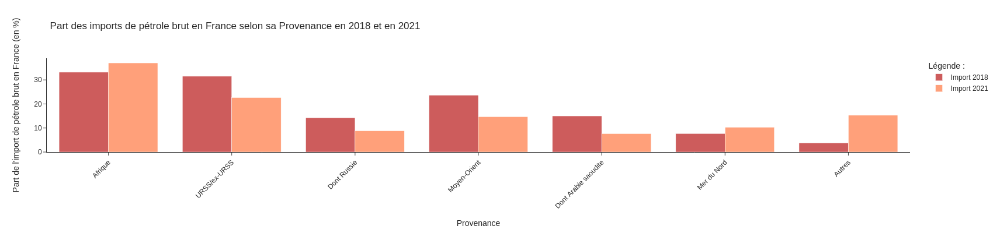

In [33]:
barchart(data_imp_prop, '2018', '2021 (p)', 'Import 2018', 'Import 2021', "Part des imports de pétrole brut en France selon sa Provenance en 2018 et en 2021", 'Provenance', "Part de l'import de pétrole brut en France (en %)")

### Production pétrole brut monde

#### Etude de la production de pétrole dans le monde en fonction du pays (données: https://data.oecd.org/fr/energy/production-de-petrole-brut.htm)

In [37]:
data_prod = pd.read_csv('Data/Production_petrole_monde.csv', sep = ',')
data_prod

,LOCATION,INDICATOR,SUBJECT,MEASURE,FREQUENCY,TIME,Value,Flag Codes
0,AUS,OILPROD,TOT,KTOE,A,2000,25081.1572,NaN
1,AUS,OILPROD,TOT,KTOE,A,2001,26611.8285,NaN
2,AUS,OILPROD,TOT,KTOE,A,2002,30307.7115,NaN
3,AUS,OILPROD,TOT,KTOE,A,2003,29403.1762,NaN
4,AUS,OILPROD,TOT,KTOE,A,2004,25785.0349,NaN
...,...,...,...,...,...,...,...,...
3251,EU27_2020,OILPROD,TOT,KTOE,A,2017,22059.9053,NaN
3252,EU27_2020,OILPROD,TOT,KTOE,A,2018,21388.4270,NaN
3253,EU27_2020,OILPROD,TOT,KTOE,A,2019,19797.0115,NaN
3254,EU27_2020,OILPROD,TOT,KTOE,A,2020,18784.9485,NaN


In [38]:
data_prod.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3256 entries, 0 to 3255
Data columns (total 8 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   LOCATION    3256 non-null   object 
 1   INDICATOR   3256 non-null   object 
 2   SUBJECT     3256 non-null   object 
 3   MEASURE     3256 non-null   object 
 4   FREQUENCY   3256 non-null   object 
 5   TIME        3256 non-null   int64  
 6   Value       3248 non-null   float64
 7   Flag Codes  8 non-null      object 
dtypes: float64(1), int64(1), object(6)
memory usage: 203.6+ KB


In [39]:
data_prod_Rus = data_prod[data_prod['LOCATION'] == 'RUS']
data_prod_Usa = data_prod[data_prod['LOCATION'] == 'USA']
data_prod_Sau = data_prod[data_prod['LOCATION'] == 'SAU']
data_prod_Irq = data_prod[data_prod['LOCATION'] == 'IRQ']
data_prod_Chn = data_prod[data_prod['LOCATION'] == 'CHN']
data_prod_Wld = data_prod[data_prod['LOCATION'] == 'WLD']
data_prod_Chn

,LOCATION,INDICATOR,SUBJECT,MEASURE,FREQUENCY,TIME,Value,Flag Codes
968,CHN,OILPROD,TOT,KTOE,A,2000,163000.000,NaN
969,CHN,OILPROD,TOT,KTOE,A,2001,163959.000,NaN
970,CHN,OILPROD,TOT,KTOE,A,2002,167000.000,NaN
971,CHN,OILPROD,TOT,KTOE,A,2003,169600.000,NaN
972,CHN,OILPROD,TOT,KTOE,A,2004,175873.000,NaN
973,CHN,OILPROD,TOT,KTOE,A,2005,181353.000,NaN
974,CHN,OILPROD,TOT,KTOE,A,2006,184766.000,NaN
975,CHN,OILPROD,TOT,KTOE,A,2007,186318.000,NaN
976,CHN,OILPROD,TOT,KTOE,A,2008,190440.000,NaN
977,CHN,OILPROD,TOT,KTOE,A,2009,189490.000,NaN


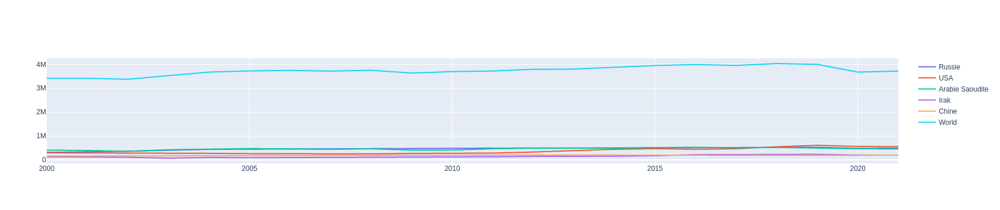

In [40]:
fig = go.Figure()

# Add traces
fig.add_trace(go.Scatter(x=data_prod_Rus["TIME"], y=data_prod_Rus['Value'],
                    mode='lines',
                    name='Russie'))
fig.add_trace(go.Scatter(x=data_prod_Usa["TIME"], y=data_prod_Usa['Value'],
                    mode='lines',
                    name='USA'))
fig.add_trace(go.Scatter(x=data_prod_Sau["TIME"], y=data_prod_Sau['Value'],
                    mode='lines',
                    name='Arabie Saoudite'))
fig.add_trace(go.Scatter(x=data_prod_Irq["TIME"], y=data_prod_Irq['Value'],
                    mode='lines',
                    name='Irak'))
fig.add_trace(go.Scatter(x=data_prod_Chn["TIME"], y=data_prod_Chn['Value'],
                    mode='lines',
                    name='Chine'))
fig.add_trace(go.Scatter(x=data_prod_Wld["TIME"], y=data_prod_Wld['Value'],
                    mode='lines',
                    name='World'))

fig.show()

In [41]:
data_prod_2021 = data_prod[data_prod["TIME"] == 2021]
data_prod_2021.rename(columns = {'LOCATION' : 'iso_alpha'}, inplace = True)
data_prod_2021

/tmp/ipykernel_19018/2547040287.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,iso_alpha,INDICATOR,SUBJECT,MEASURE,FREQUENCY,TIME,Value,Flag Codes
21,AUS,OILPROD,TOT,KTOE,A,2021,15577.2718,NaN
43,AUT,OILPROD,TOT,KTOE,A,2021,558.6789,NaN
65,BEL,OILPROD,TOT,KTOE,A,2021,0.0000,NaN
87,CAN,OILPROD,TOT,KTOE,A,2021,194358.0035,NaN
109,CZE,OILPROD,TOT,KTOE,A,2021,85.2680,NaN
...,...,...,...,...,...,...,...,...
3167,MDG,OILPROD,TOT,KTOE,A,2021,0.0000,NaN
3189,RWA,OILPROD,TOT,KTOE,A,2021,0.0000,NaN
3211,SWZ,OILPROD,TOT,KTOE,A,2021,0.0000,NaN
3233,UGA,OILPROD,TOT,KTOE,A,2021,0.0000,NaN


In [42]:
data_prod_2021.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 148 entries, 21 to 3255
Data columns (total 8 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   iso_alpha   148 non-null    object 
 1   INDICATOR   148 non-null    object 
 2   SUBJECT     148 non-null    object 
 3   MEASURE     148 non-null    object 
 4   FREQUENCY   148 non-null    object 
 5   TIME        148 non-null    int64  
 6   Value       147 non-null    float64
 7   Flag Codes  1 non-null      object 
dtypes: float64(1), int64(1), object(6)
memory usage: 10.4+ KB


In [43]:
## garde seulement les valeurs supérieures à 0
data_prod_2021.drop(data_prod_2021[data_prod_2021['Value'] == 0].index, inplace = True)

/tmp/ipykernel_19018/2387117541.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [44]:
data_prod_2021['iso_alpha'].unique()

array(['AUS', 'AUT', 'CAN', 'CZE', 'DNK', 'FRA', 'DEU', 'GRC', 'HUN',
       'ITA', 'JPN', 'KOR', 'MEX', 'NLD', 'NZL', 'NOR', 'POL', 'SVK',
       'ESP', 'TUR', 'GBR', 'USA', 'OEU', 'ALB', 'DZA', 'ARG', 'AZE',
       'BLR', 'BRA', 'BRN', 'BGR', 'CHL', 'CHN', 'COL', 'HRV', 'EGY',
       'GEO', 'GHA', 'IND', 'IDN', 'IRN', 'ISR', 'KAZ', 'LTU', 'MYS',
       'MDA', 'NGA', 'PAK', 'PER', 'PHL', 'ROU', 'RUS', 'SAU', 'SVN',
       'ZAF', 'SDN', 'TWN', 'THA', 'UKR', 'ARE', 'VNM', 'WLD', 'SRB',
       'EU28', 'G20', 'AGO', 'BHR', 'BOL', 'CMR', 'COG', 'CIV', 'CUB',
       'COD', 'ECU', 'GAB', 'GTM', 'IRQ', 'JOR', 'KWT', 'KGZ', 'LBY',
       'MNG', 'MAR', 'MMR', 'NER', 'OMN', 'QAT', 'SYR', 'TJK', 'TTO',
       'TUN', 'TKM', 'UZB', 'VEN', 'YEM', 'GNQ', 'EU27_2020'],
      dtype=object)

In [45]:
liste_pays = ['G20', 'WLD']

In [46]:
data_prod_sel = data_prod_2021[~data_prod_2021['iso_alpha'].isin(liste_pays)].sort_values('Value', ascending=False)[:20]
data_prod_sel

,iso_alpha,INDICATOR,SUBJECT,MEASURE,FREQUENCY,TIME,Value,Flag Codes
659,USA,OILPROD,TOT,KTOE,A,2021,559454.6637,NaN
1627,RUS,OILPROD,TOT,KTOE,A,2021,495676.8175,NaN
1649,SAU,OILPROD,TOT,KTOE,A,2021,463617.8124,NaN
2463,IRQ,OILPROD,TOT,KTOE,A,2021,202630.6027,NaN
989,CHN,OILPROD,TOT,KTOE,A,2021,199263.7650,NaN
87,CAN,OILPROD,TOT,KTOE,A,2021,194358.0035,NaN
879,BRA,OILPROD,TOT,KTOE,A,2021,150384.8446,NaN
681,OEU,OILPROD,TOT,KTOE,A,2021,146686.3254,NaN
1847,ARE,OILPROD,TOT,KTOE,A,2021,135697.9198,NaN
2551,KWT,OILPROD,TOT,KTOE,A,2021,125701.3790,NaN


/home/mathieu.vialat@Digital-Grenoble.local/Documents/DataForGood/Data4good/Modules/Module.py:398: UserWarning:

Setting the 'color' property will override the edgecolor or facecolor properties.



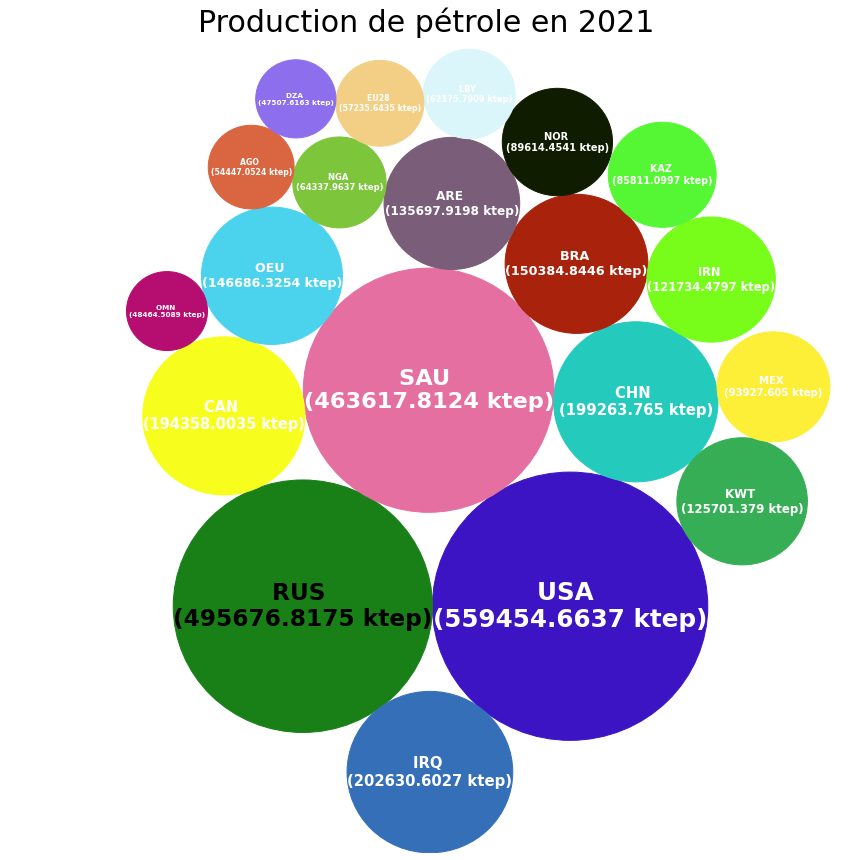

In [47]:
BubbleCloud(data_prod_sel, 'iso_alpha', 'Value', label_highlight = 'RUS')

### Prix à l'import

#### Etude du prix du baril de pétrole à l'import en fonction du pays (données: https://data.oecd.org/fr/energy/prix-du-petrole-brut-a-l-importation.htm)

In [48]:
data_prix_imp = pd.read_csv('Data/Prix_import_France.csv', sep = ',')
data_prix_imp_Fra =  data_prix_imp[(data_prix_imp["LOCATION"] == 'FRA') & (data_prix_imp["TIME"] > 2017)]
data_prix_imp_Fra["DATETIME"] =  pd.to_datetime(data_prix_imp_Fra["TIME"], format = '%Y')
data_prix_imp_Fra

/tmp/ipykernel_19018/1147717393.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,LOCATION,INDICATOR,SUBJECT,MEASURE,FREQUENCY,TIME,Value,Flag Codes,DATETIME
179,FRA,OILIMPPRICE,TOT,USD_BAR,A,2018,71.59,NaN,2018-01-01
180,FRA,OILIMPPRICE,TOT,USD_BAR,A,2019,64.98,NaN,2019-01-01
181,FRA,OILIMPPRICE,TOT,USD_BAR,A,2020,44.04,NaN,2020-01-01
182,FRA,OILIMPPRICE,TOT,USD_BAR,A,2021,71.70,NaN,2021-01-01
183,FRA,OILIMPPRICE,TOT,USD_BAR,A,2022,105.06,NaN,2022-01-01


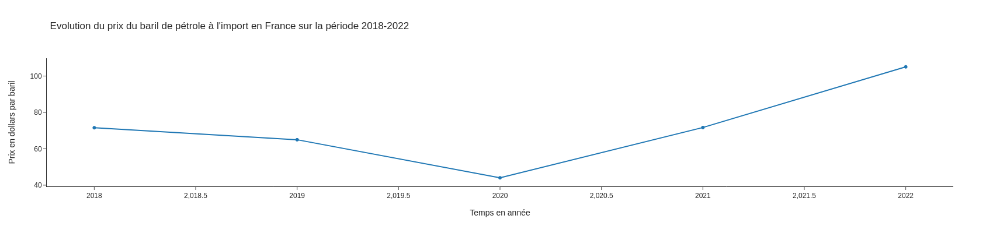

In [49]:
fig = go.Figure()
#fig.add_trace(go.Scatter(x=df_list[1].index, y=df_list[1]["Prix au détail de 100 kWh PCI de FOL TBTS"].astype(float), name='Prix FOL TBTS'))
fig.add_trace(go.Scatter(x=data_prix_imp_Fra['TIME'], y=data_prix_imp_Fra['Value'], name="Prix du baril de pétrole à l'import en France"))
fig.update_layout(title_text="Evolution du prix du baril de pétrole à l'import en France sur la période 2018-2022", legend_title_text = "Légende :", width=800, height=400, template='simple_white')
fig.update_xaxes(title_text='Temps en année')
fig.update_yaxes(title_text='Prix en dollars par baril')
fig.show()

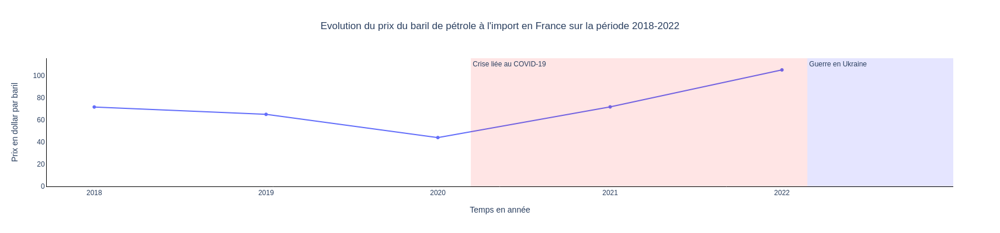

In [50]:
scatter_plot_2lines(x1 = data_prix_imp_Fra['DATETIME'], y1 = data_prix_imp_Fra['Value'], label_1 = "Prix du baril de pétrole à l'import en France", x_label = 'Temps en année',
                    y_label = 'Prix en dollar par baril', title = "Evolution du prix du baril de pétrole à l'import en France sur la période 2018-2022")

### Import provenant de la Russie

#### Etude de la part des imports de pétrole provenant de la Russie après février 2021 (données: https://www.iea.org/data-and-statistics/data-product/monthly-reliance-on-russian-oil-for-oecd-countries)

In [51]:
## Import et nettoyage du tableau de la part des imports de pétrole venant de la Russie sur les imports totaux pour chaque pays de l'OCDE de Feb 2021 à Jan 2023
## Dictionnaire de transformation de la date (mois)
dict_transfo = {'Jan' : '01', 'Feb' : '02', 'Mar' : '03', 'Apr' : '04', 'May' : '05', 'Jun' :  '06', 'Jul' : '07', 'Aug' : '08', 'Sep' : '09', 'Oct' : '10', 'Nov' : '11', 'Dec' : '12'}

data_imp_rus = pd.read_csv('../Data/Russie_imports_2022_2023.csv', sep = ';')
data_imp_rus.set_index('Unnamed: 0', inplace = True)
for col in data_imp_rus.columns:
    data_imp_rus[col] = data_imp_rus[col].str.replace('%', '').astype(float)
data_imp_rus = data_imp_rus.T
data_imp_rus["Date"] = data_imp_rus.index
for m in dict_transfo.keys():
    data_imp_rus["Date"] = data_imp_rus["Date"].str.replace(m, dict_transfo[m])
data_imp_rus["Date"] = data_imp_rus["Date"].str.replace('21', '2021')
data_imp_rus["Date"] = data_imp_rus["Date"].str.replace('22', '2022')
data_imp_rus["Date"] = data_imp_rus["Date"].str.replace('23', '2023')
data_imp_rus["Date"] = pd.to_datetime(data_imp_rus["Date"])
data_imp_rus["Date"].dt.strftime('%Y-%m-%d')
data_imp_rus.set_index("Date", inplace = True)
data_imp_rus

Unnamed: 0,Australia,Austria,Belgium,Canada,Chile,Czech Republic,Denmark,Estonia,Finland,France,...,Spain,Sweden,Switzerland,Turkey,United Kingdom,United States,OECD Total,OECD Americas,OECD Asia Oceania,OECD Europe
Date,,,,,,,,,,,,,,,,,,,,,
2021-02-01,0.0,0.1,21.4,0.0,0.0,33.1,18.7,48.5,75.1,19.7,...,8.7,8.8,0.0,22.0,13.8,6.5,12.5,5.2,3.7,21.4
2021-03-01,0.7,4.0,19.1,1.4,0.0,36.4,11.5,34.6,75.0,15.7,...,5.6,7.2,0.0,17.6,21.5,9.4,13.8,7.6,5.8,21.1
2021-04-01,0.0,5.8,20.7,0.6,0.0,24.8,24.5,62.2,65.5,19.9,...,8.9,9.8,0.0,22.4,16.1,8.9,13.4,7.1,6.0,21.0
2021-05-01,0.8,8.4,23.9,0.1,0.0,34.4,14.9,60.1,48.5,15.2,...,10.5,9.8,0.0,20.2,16.2,10.3,13.8,8.2,6.1,20.7
2021-06-01,0.0,4.2,16.7,2.2,0.0,24.4,6.5,46.9,59.7,16.8,...,7.6,11.2,0.0,25.1,13.4,9.5,13.6,7.9,5.2,21.1
2021-07-01,0.0,5.3,17.0,0.5,0.0,28.8,15.1,52.8,39.7,11.4,...,8.5,17.3,0.0,23.2,11.2,9.0,13.5,7.1,3.0,21.8
2021-08-01,0.0,3.9,18.9,1.2,0.0,27.3,13.3,52.3,64.5,12.7,...,10.2,13.3,0.0,22.3,8.4,9.4,13.4,7.6,4.1,21.1
2021-09-01,0.0,5.9,23.7,0.4,0.0,32.7,23.3,41.6,59.8,10.9,...,6.3,9.4,0.0,18.1,11.9,7.3,13.0,5.9,4.2,21.2
2021-10-01,0.0,5.7,17.3,1.4,0.0,40.4,15.4,21.7,69.9,8.7,...,13.2,15.0,0.0,23.8,10.4,8.1,14.4,6.8,5.4,22.4


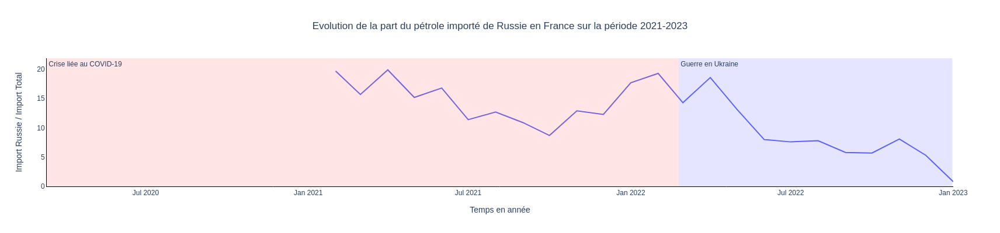

In [52]:
scatter_plot_2lines(x1 = data_imp_rus.index, y1 = data_imp_rus['France'], label_1 = "Part du pétrole importé de Russie", x_label = 'Temps en année',
                    y_label = 'Import Russie / Import Total', title = "Evolution de la part du pétrole importé de Russie en France sur la période 2021-2023")

## Données totales

In [53]:
df_tot = ouverture_df('Data/7.-Ensemble-des-series.2023-04.csv', '2018-01', '2023-01')
df_tot.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 61 entries, 2018-01-01 to 2023-01-01
Columns: 195 entries, Période to Prix spot du gaz PEG (point échange gaz) en France (en €/MWh)
dtypes: object(195)
memory usage: 93.4+ KB


In [54]:
df_tot.columns

Index(['Période', 'Production totale brute d'électricité (en GWh)',
       'Production totale nette d'électricité (en GWh)',
       'Production brute d'électricité nucléaire (en GWh)',
       'Production nette d'électricité nucléaire (en GWh)',
       'Production brute d'électricité hydraulique (en GWh)',
       'Production nette d'électricité hydraulique (en GWh)',
       'Production brute d'électricité éolienne (en GWh)',
       'Production nette d'électricité éolienne (en GWh)',
       'Production brute d'électricité photovoltaïque (en GWh)',
       ...
       'Cours moyen du pétrole brut «brent» daté (en dollars/bl)',
       'Cours moyen du dollar (en euros)',
       'Prix moyen du charbon importé (en euro/t)',
       'Prix moyen du pétrole brut importé (en euro/t)',
       'Prix moyen du pétrole brut importé (en dollar/bl)',
       'Prix moyen des produits pétroliers raffinés importés (en euro/t)',
       'Prix estimé de l'électricité exportée (en centimes d'euro/kWh)',
       'Pr

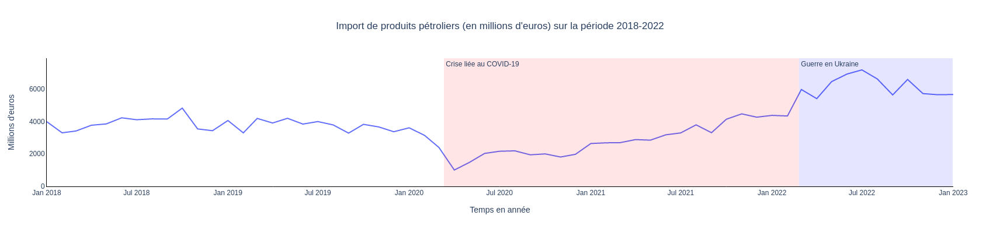

In [55]:
scatter_plot_2lines(x1 = df_tot.index, y1 = df_tot["1.2 Importations de produits pétroliers (en millions d'euros CAF)"].astype(float), label_1 = "Import de pétrole en millions d'euros", x_label = 'Temps en année',
                    y_label = "Millions d'euros", title = "Import de produits pétroliers (en millions d'euros) sur la période 2018-2022")

# Investigation on Electricity from dido data

In [11]:
df_list = read_electricity_data("2018-01","2023-02")
    
df_price_menage_electricity = df_list[0]
df_price_industry_electricity = df_list[1]
df_electricity_2023 = df_list[2]
df_summaryze_electricity = df_list[3]

1.2.-Prix-menages-Electricite.2023-04.csv
2.2.-Prix-industriels-Electricite.2023-04.csv
3.1.-Electricite.2023-04.csv
4.2-Synthese-Electricite.2023-04.csv


In [12]:
labels = ["toutes tranches","tranches DA", "tranches DB", "tranches DC","tranches DD","tranches DE"]
title = "Prix au détail de l'électricité TTC dans une menage sur la période 2018-2022"
x_title ='Temps en année'
y_title = "Prix au détail de l'électricité TTC (€)"

    
plot_from_df(df_price_menage_electricity,labels, title, x_title, y_title)#, save=True, path_to_save='images/fig1.png')

In [13]:
labels = ["tranches IA à IF","tranches IA", "tranches IB", "tranches IC","tranches ID","tranches IE", "tranches IF","tranches IG","toutes tranches" ]
title = "Prix au détail de l'électricité hors TVA dans l'industrie sur la période 2018-2022"
x_title ='Temps en année'
y_title = "Prix au détail de l'électricité hors TVA (€)"
plot_from_df(df_price_industry_electricity,labels, title, x_title, y_title)#, save=True, path_to_save='images/fig2.png')

In [14]:
labels = ["Electricite industriels","Electricite dans menage"]
title = "Prix au détail de l'électricité TTC dans l'industrie et dans le menage sur la période 2018-2022"
x_title = 'Temps en année'
y_title = "Prix au détail de l'électricité (€)"
plot_first_column_from_df1_df2(df_price_industry_electricity,df_price_menage_electricity,labels, title, x_title, y_title, 0.78)#, save=True, path_to_save='images/fig3.png')


In [15]:
production_net = ["Production totale nette d'électricité (en GWh)",
                        "Production nette d'électricité nucléaire (en GWh)",
                        "Production nette d'électricité hydraulique (en GWh)",
                        "Production nette d'électricité éolienne (en GWh)",
                        "Production nette d'électricité photovoltaïque (en GWh)",
                        "Production nette d'électricité thermique (en GWh)"]
  

    
labels=["totale","électricité nucléaire","électricité hydraulique","électricité éolienne","électricité photovoltaïque","électricité thermique"]
title = "Production nette d'électricité (GWh) sur sur la période 2018-2023"
x_title = 'Temps en année'
y_title = "Production nette d'électricité (GWh)"
plot_from_df_with_list_col(df_electricity_2023,production_net, labels, title, x_title, y_title)#, save=True, path_to_save='images/fig4.png')

In [ ]:
production = ["1. Production (brute) d'électricité hydraulique, éolienne et photovoltaïque (en GWh)",
                "1.1 Production brute d'électricité hydraulique (en GWh)",
                "1.2 Production brute d'électricité éolienne (en GWh)",
                "1.3 Production brute d'électricité solaire photovoltaïque (en GWh)",
                "2. Production nucléaire (équivalent primaire à la production, sous forme de chaleur) (en GWh)"]

labels =["total: hydraulic - eolic - solar electricity ","hydraulic electricity","eolic electricity","solar electricity","production nuclear"]
title ="Production (brute) d'électricité renouvable (en GWh) sur la période 2018-2023"
x_title = 'Temps en année'
y_title = "Production brute d'électricité (GWh)"
plot_from_df_with_list_col(df_summaryze_electricity, production, labels, title, x_title, y_title)#, save=True, path_to_save='images/fig5.png')

In [16]:
import_export = ["3. Solde importateur (importations - exportations) d'électricité (en GWh)",
                "3.1 Importations d'électricité (en GWh)",
                "3.2 Exportations d'électricité (en GWh)"]
labels =["Total_import_export","import", "export"]
title = "Import/Export (GWh) sur la période 2018-2023"
x_title = 'Temps en année'
y_title = "Import/Export (GWh)"
plot_from_df_with_list_col(df_summaryze_electricity, import_export, labels, title, x_title, y_title)#, save=True, path_to_save='images/fig6.png')

In [17]:
consumption = ["4. Consommation primaire d'énergie nucléaire, hydraulique, éolienne et photovoltaïque brute (en GWh)",
                "5. Consommation d'électricité primaire et d'équivalent primaire d'électricité nucléaire CVC-CJO (en GWh)",
                "6. Consommation d'électricité primaire et d'équivalent primaire d'électricité nucléaire CVS-CVC-CJO (en GWh)"]
labels =["non nucleiare","nucleiare CVC-CJO", "nucleiare CVS-CVC-CJO"]
title ="Consommation primaire d'énergie sur la période 2018-2023"
x_title = 'Temps en année'
y_title = "Consommation primaire d'énergie (GWh)"
plot_from_df_with_list_col(df_summaryze_electricity, consumption, labels, title, x_title, y_title)#, save=True, path_to_save='images/fig7.png')

# Investigation on Electricity from RTE data


In [25]:
df = read_rte_data()
print(df)
list_resource =["Gaz", "Nucléaire", "Fioul", "Charbon"]
list_series = list_series_data(df, list_resource)
#print(list_series)
plot_subplot_resources(list_series,list_resource)#, save=True, path_to_save='images/rte.png')

                     Autre  Biomasse  Charbon  Fioul     Gaz   
2018-01-01 00:00:00    0.0       0.0     -9.0  -12.0   383.0  \
2018-01-01 01:00:00    0.0       0.0     -9.0  -11.5   382.5   
2018-01-01 02:00:00    0.0       0.0     -9.0  -11.0   381.5   
2018-01-01 03:00:00    0.0       0.0     -9.0  -11.5   383.5   
2018-01-01 04:00:00    0.0       0.0     -9.5  -11.0   383.5   
...                    ...       ...      ...    ...     ...   
2023-04-24 20:00:00    0.0     155.5      0.0    1.0  4020.0   
2023-04-24 21:00:00    0.0     154.0      0.0    0.5  4017.5   
2023-04-24 22:00:00    0.0     135.5     -0.5    1.0  3710.5   
2023-04-24 23:00:00    0.0     130.0     -0.5    0.5  3562.5   
2023-04-25 00:00:00    0.0     130.0     -1.0    0.5  3560.0   

                     Hydraulique STEP  Hydraulique fil de l'eau / éclusée   
2018-01-01 00:00:00           -1106.5                               229.0  \
2018-01-01 01:00:00           -1305.0                               153.0   
